In [1]:
print(1)

1


In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [12]:
!curl -L -o "03-files.zip" "https://drive.google.com/uc?export=download&id=19nRYZZRy1BeswhwKUb_6A4gNtBvX8KG2"
!unzip -o 03-files.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 3731k  100 3731k    0     0  1207k      0  0:00:03  0:00:03 --:--:-- 2023k
Archive:  03-files.zip
   creating: 03-files/
  inflating: 03-files/waldo_templ_hires.png  
  inflating: __MACOSX/03-files/._waldo_templ_hires.png  
  inflating: 03-files/wally2.jpg     
  inflating: __MACOSX/03-files/._wally2.jpg  
  inflating: 03-files/wally1.jpg     
  inflating: __MACOSX/03-files/._wally1.jpg  
  inflating: 03-files/waldo1.jpg     
  inflating: __MACOSX/03-files/._waldo1.jpg  
  inflating: 03-files/waldo0.jpg     
  inflating: __MACOSX/03-files/._waldo0.jpg  
  inflating: 03-files/waldo2.jpg     
  inflating: __MACOSX/03-files/._waldo2.jpg  
   creating: 03-files/.vscode/
  inflating: 03-files/waldo_templ2.png  
  inflating: __MACOSX/03-files/._waldo_temp

In [13]:
im = cv2.imread('03-files/wally1.jpg')

In [14]:
type(im), im.dtype, im.shape

(numpy.ndarray, dtype('uint8'), (726, 968, 3))

In [19]:
im[:3,:3]

array([[[244, 245, 243],
        [244, 245, 243],
        [244, 244, 244]],

       [[244, 244, 244],
        [244, 244, 244],
        [244, 243, 245]],

       [[244, 242, 248],
        [244, 242, 248],
        [244, 242, 248]]], dtype=uint8)

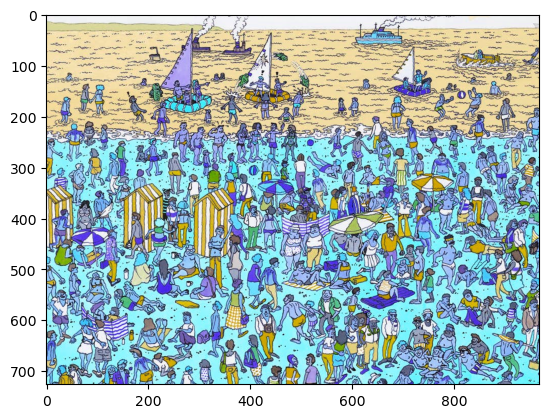

In [22]:
plt.imshow(im) # The color seems a bit blueish

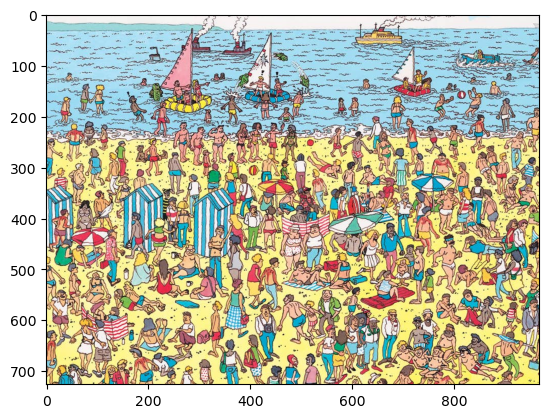

In [25]:
plt.imshow(im[:,:,::-1]);

In [23]:
def show_img(img, ax=None, figsize=(10, 8)):
    if not ax: _, ax  = plt.subplots(1,1, figsize=figsize)
    if len(img.shape) == 2: img = np.tile(img[:,:,None], 3)
    ax.imshow(img[:, :, ::-1])
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    return ax

((726, 968, 3), np.int64(2108304))

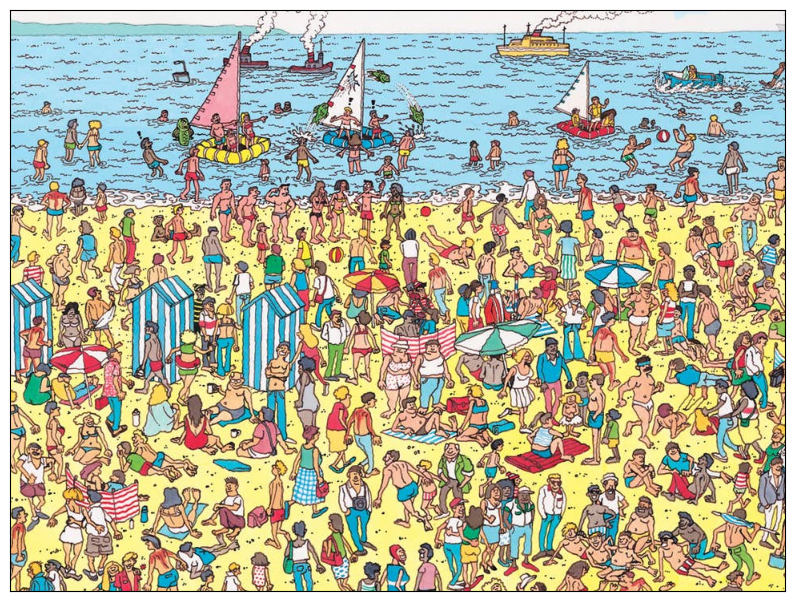

In [30]:
show_img(im)
im.shape, np.prod(im.shape)

In [31]:
# Resizing
im_r = cv2.resize(im, None, fx=0.5, fy=0.5)
im_r.shape, np.prod(im_r.shape)

((363, 484, 3), np.int64(527076))

<Axes: >

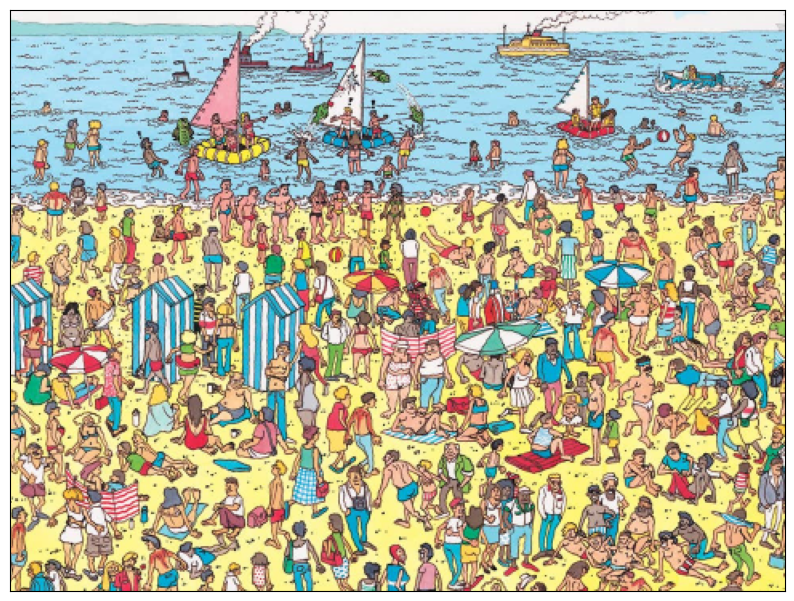

In [32]:
show_img(im_r)

In [33]:
# Matching template

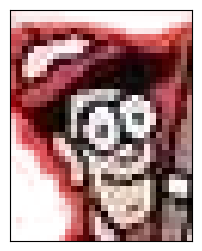

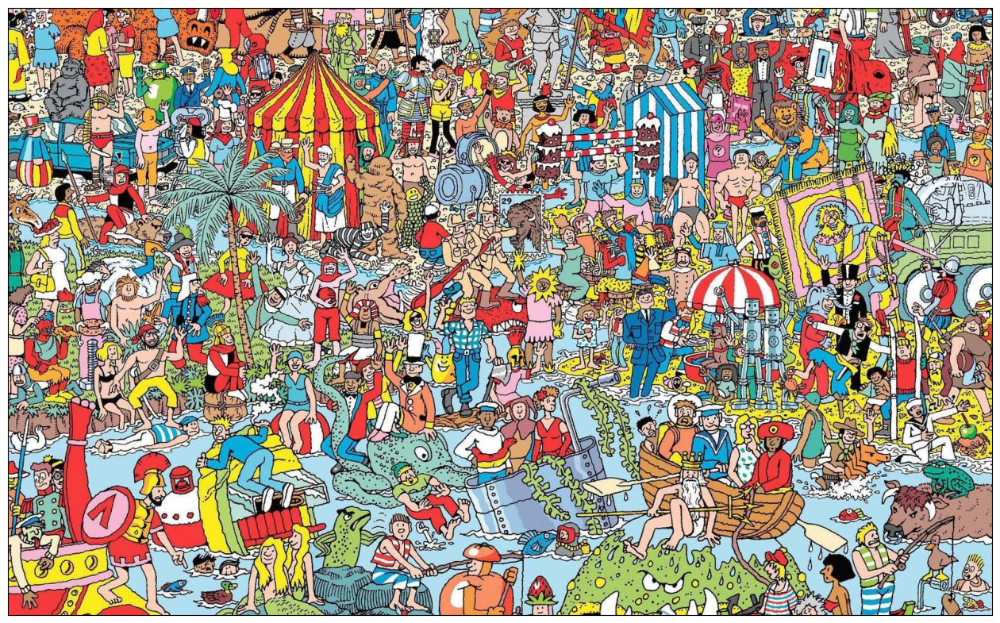

In [48]:
templ = cv2.imread('03-files/waldo_templ3.png')
show_img(templ, figsize=(3,3))
im = cv2.imread('03-files/waldo1.jpg')
show_img(im, figsize=(16,16));

In [49]:
H, W = im.shape[:2]
print(f'{W} x {H}')
h,w = templ.shape[:2]
print(f'{w} x {h}')

1590 x 981
30 x 38


In [50]:
# Sliding window

In [51]:
from tqdm.notebook import trange
stride = 1
scores = np.zeros((H-h+1, W-w+1))
for x in range(0, W-w+1, stride):
    for y in range(0, H-h+1, stride):
        patch = im[y:y+h, x:x+w]
        scores[y,x] = (patch==templ).mean()

In [52]:
scores.min(), scores.max()

(np.float64(0.00029239766081871346), np.float64(0.1956140350877193))

In [53]:
y_max, x_max = np.unravel_index(scores.argmax(), scores.shape)
y_max, x_max

(np.int64(74), np.int64(1262))

<Axes: >

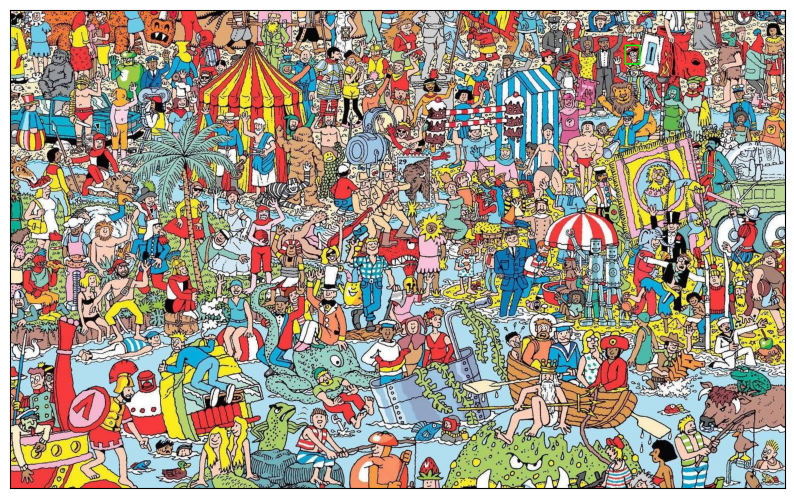

In [54]:
im_copy = im.copy()
cv2.rectangle(im_copy, (x_max, y_max), (x_max+w, y_max+h), (0,255,0), thickness=2)
show_img(im_copy)

In [55]:
# Using OpenCv matchTemplate

In [58]:
def match_img(im, templ, method=cv2.TM_SQDIFF_NORMED):
    scores = cv2.matchTemplate(im, templ, method)
    if method in [cv2.TM_SQDIFF_NORMED, cv2.TM_SQDIFF]: scores = -scores
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(scores)
    print(f'max_score: {max_val:.3}')
    return max_loc, scores

In [59]:
%%time
max_loc, scores = match_img(im, templ)

max_score: -0.194
CPU times: user 49.1 ms, sys: 4.65 ms, total: 53.8 ms
Wall time: 52.9 ms


<Axes: >

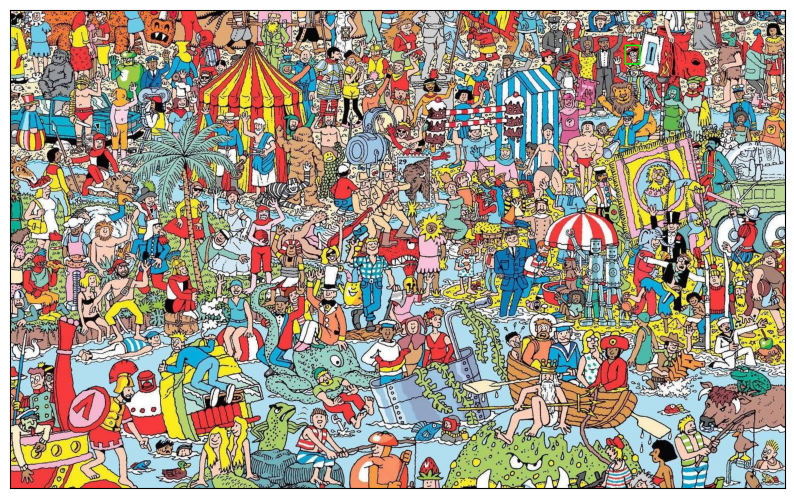

In [62]:
im_copy = im.copy()
cv2.rectangle(im_copy, (max_loc[0], max_loc[1]),(max_loc[0]+w, max_loc[1]+h), (0,255,0), thickness=2)
show_img(im_copy)

In [3]:
def show_matches(im, max_loc, scores):
    im_copy = im.copy()
    top_left, btm_right = max_loc, (max_loc[0]+w, max_loc[1]+h)
    cv2.rectangle(im_copy, top_left, btm_right, (0,255,0), thickness=3)
    fig, ax  = plt.subplots(1,2,figsize=(24,20))
    ax[0].imshow(im_copy[:, :, ::-1])
    im_scores = ax[1].imshow(scores, cmap='gray')
    [(ax_.xaxis.set_visible(False), ax_.yaxis.set_visible(False)) for ax_ in ax]
    return fig, ax

(<Figure size 2400x2000 with 2 Axes>,
 array([<Axes: >, <Axes: >], dtype=object))

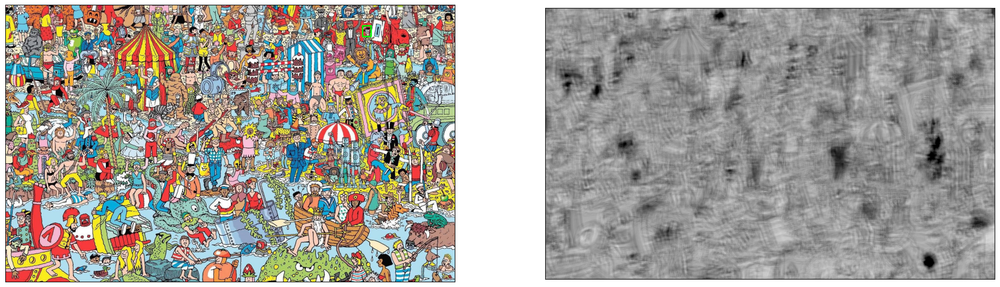

In [64]:
show_matches(im, max_loc, scores)

<Axes: >

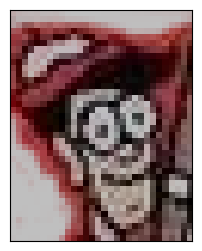

In [65]:
alpha = 0.75
beta = 0
templ1 = np.clip(alpha * templ + beta, 0, 255).astype(np.uint8)
show_img(templ1, figsize=(3,3))

max_score: -0.174


(<Figure size 2400x2000 with 2 Axes>,
 array([<Axes: >, <Axes: >], dtype=object))

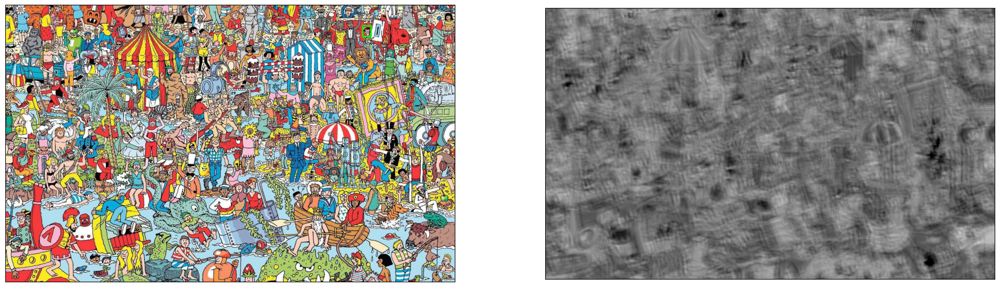

In [67]:
show_matches(im, *match_img(im, templ1))

max_score: -0.194
max_score: 0.919
max_score: 0.746


[(<Figure size 2400x2000 with 2 Axes>,
  array([<Axes: >, <Axes: >], dtype=object)),
 (<Figure size 2400x2000 with 2 Axes>,
  array([<Axes: >, <Axes: >], dtype=object)),
 (<Figure size 2400x2000 with 2 Axes>,
  array([<Axes: >, <Axes: >], dtype=object))]

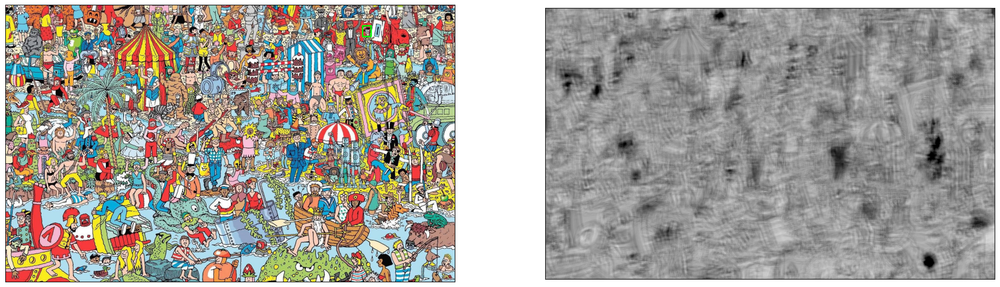

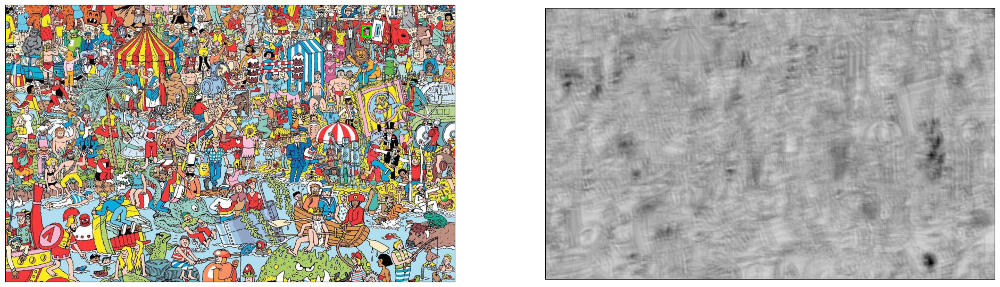

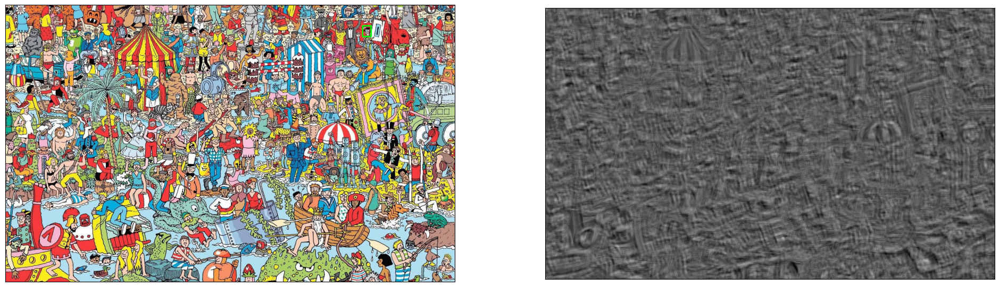

In [68]:
methods = [cv2.TM_SQDIFF_NORMED, cv2.TM_CCORR_NORMED, cv2.TM_CCOEFF_NORMED]
[show_matches(im, *match_img(im, templ, method)) for method in methods]

<Axes: >

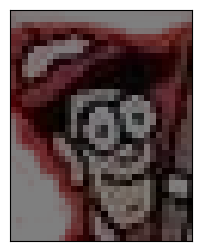

In [69]:
alpha = 0.5
beta = 0
templ2 = np.clip(alpha * templ + beta, 0, 255).astype(np.uint8)
show_img(templ2, figsize=(3,3))

max_score: 0.746


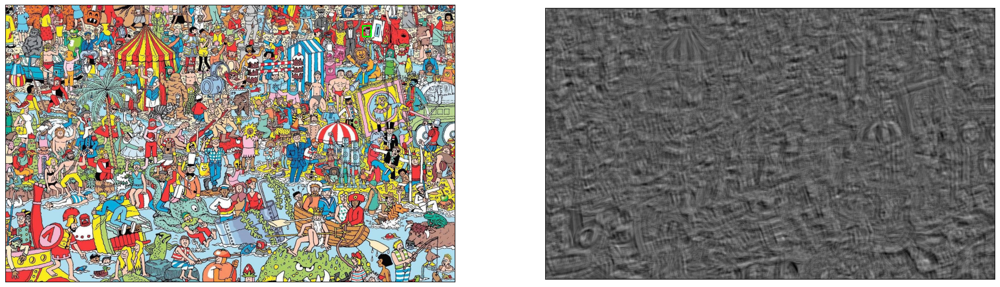

In [70]:
show_matches(im, *match_img(im, templ2, cv2.TM_CCOEFF_NORMED));

max_score: 0.74


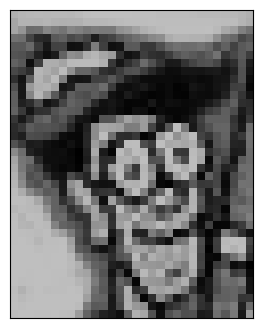

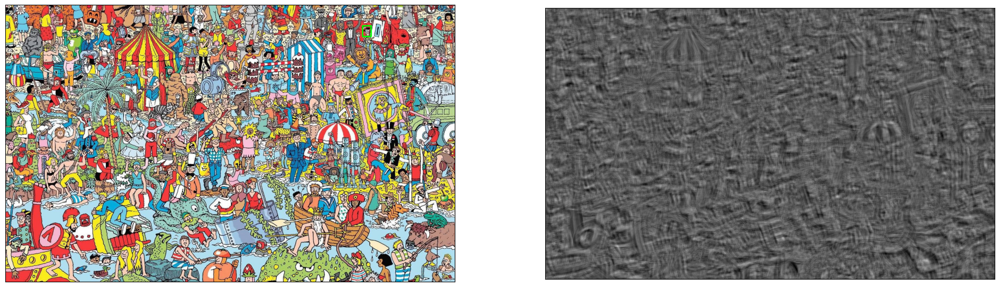

In [71]:
templ1_gray = np.tile(templ1.mean(axis=-1,keepdims=True).astype('uint8'), (1,1,3))
show_img(templ1_gray, figsize=(4,4));
show_matches(im, *match_img(im, templ1_gray, cv2.TM_CCOEFF_NORMED));